In [3]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

from astropy.io import fits
from astropy.wcs import WCS, FITSFixedWarning
from astropy.visualization import make_lupton_rgb
from astropy.io import fits

from astropy import units as u
from astropy.coordinates import SkyCoord

import numpy as np
import pandas as pd
from scipy import integrate

import warnings
warnings.filterwarnings("ignore", "'cdfix' made the change 'Success'", FITSFixedWarning)

In [19]:
def fetch_cutout(ra, dec, pixscale=0.262, layer="ls-dr9"):
    # From https://www.legacysurvey.org/dr9/description/:
    # Pixscale=0.262 will return (approximately) the native pixels used by the Tractor.
    url = f"https://www.legacysurvey.org/viewer/cutout.fits?ra={ra}&dec={dec}&layer={layer}&pixscale={pixscale:0.2f}"
    #print(url)
    fp = fits.open(url)
    header = fp[0].header.copy()
    data = fp[0].data.copy()
    #np.save("dr8_stamps/ra_{0}_dec_{1}.npy".format(ra, dec), data)
    del fp[0].data
    del fp[0]
    fp.close()
    return header, data

def compute_distance_modulus(dist_in_pc):
    modulus = 5 * np.log10(dist_in_pc) - 5
    return modulus

def apparent_to_absolute(apparent_mag, dist_in_pc):
    return apparent_mag - compute_distance_modulus(dist_in_pc)

def UV_nanomaggies_to_L(flux_nanomaggies, redshift, NUV=True):
    if NUV:
        Mabs_solar_AB = 10.16 # arxiv/1804.07788
    else:
        Mabs_solar_AB = 17.30 # arxiv/1804.07788
    apparent_mag = nanomaggies_to_Pogson_mag(flux_nanomaggies)
    luminosity_dist = compute_luminosity_distance(redshift)
    absolute_mag = apparent_to_absolute(apparent_mag, luminosity_dist)
    print("abs mag", absolute_mag)
    Lum = 10 ** (-0.4*(absolute_mag ))/((10**(-0.4* Mabs_solar_AB))*4*np.pi*100)#*4*np.pi*luminosity_dist**2)
    print("np.log10(lum)", np.log10(Lum))
    return Lum

def UV_mag_to_L(apparent_mag, redshift, NUV=True):
    if NUV:
        Mabs_solar_AB = 10.16 # arxiv/1804.07788
    else:
        Mabs_solar_AB = 17.30 # arxiv/1804.07788
    luminosity_dist = compute_luminosity_distance(redshift)
    absolute_mag = apparent_to_absolute(apparent_mag, luminosity_dist)
    print("abs mag", absolute_mag)
    Lum = 10 ** (-0.4*(absolute_mag ))/((10**(-0.4* Mabs_solar_AB))*4*np.pi*100)#*4*np.pi*luminosity_dist**2)
    print("np.log10(lum)", np.log10(Lum))
    return Lum

def log_SFR_from_NUV(flux_nanomaggies_NUV, redshift):
    luminosity = UV_nanomaggies_to_L(flux_nanomaggies_NUV, redshift, NUV=True)
    log_SFR = np.log10(luminosity) - 9.33
    return log_SFR


def log_SFR_from_FUV(flux_nanomaggies_FUV, redshift):
    luminosity = UV_nanomaggies_to_L(flux_nanomaggies_FUV, redshift, NUV=False)
    log_SFR = np.log10(luminosity) - 9.51
    return log_SFR


def comoving_integrand(a):
    cosmo_dictionary={'Omega_matter_0': 0.3,
                      'Omega_radiation_0': 0,
                      'Omega_$\lambda$_0': 0.7,
                      "H_0":70}
    H_0 = cosmo_dictionary['H_0']  # km/s/Mpc
    Om0_m = cosmo_dictionary['Omega_matter_0']
    Om0_r = cosmo_dictionary['Omega_radiation_0']
    Om0_lambda = cosmo_dictionary['Omega_$\lambda$_0']
    H_of_a = H_0*np.sqrt(Om0_r*a**-4 + Om0_m*a**-3 + Om0_lambda)
    return 1 / (a**2*H_of_a)


def calculate_chi_of_a(a0, af):
    """Integrate comoving distance in terms of the 
    scale factor of the Universe, a,
    params:
    a0: float, lower integration limit
    af: float, upper integration limit
    """
    c = 3e8 *u.m/u.s  # speed of light
    comoving_depth = (c * integrate.quad(comoving_integrand, a0, af)[0]*(u.s*u.Mpc/u.km)).to(u.pc)
    return comoving_depth.value



def compute_luminosity_distance(redshift):
    scale_factor = 1. / (1. + redshift)
    final_scale_factor = 1.
    d_L = calculate_chi_of_a( scale_factor, final_scale_factor) / scale_factor
    return d_L


def nanomaggies_to_Pogson_mag(flux):
    # input: flux in nanomaggies
    if flux>0:
        m = 22.5 - 2.5*np.log10(flux)
    else:
        m = 1000
    return m

def Pogson_mag_to_nanomaggies(m):
    flux = 10**(-(m-22.5)/2.5)
    return flux

def return_cutout(img, rad):
    img_len1 = img.shape[0]
    img_len2 = img.shape[1]
    if np.ceil(rad) > img_len1*0.5:
        return img
    if np.ceil(rad) > img_len2 * 0.5:
        return img
    cutout = img[int(img_len1*0.5-np.ceil(rad)):int(img_len1*0.5+np.ceil(rad)),
                 int(img_len2*0.5-np.ceil(rad)):int(img_len2*0.5+np.ceil(rad))]
    return cutout

def fiber_cutout(img, telescope_type):
    if telescope_type=='MMT':
        rad = 1.5 * 0.5/0.262  # arcsec
    elif telescope_type=="AAT":
        rad = 2 * 0.5/0.262   # arcsec
    elif telescope_type=="NSA" or telescope_type=="SDSS":
        rad = 3 * 0.5/0.262   # arcsec
    
    img_len1 = img.shape[0]
    img_len2 = img.shape[1]
    cutout = img[int(img_len1*0.5-np.ceil(rad)):int(img_len1*0.5+np.ceil(rad)),
                 int(img_len2*0.5-np.ceil(rad)):int(img_len2*0.5+np.ceil(rad))]
    return cutout

def gather_photometry(ra, 
                      dec, 
                      halflightradius, 
                      telescope_type, 
                      redshift, 
                      rbandabsmag,
                      halpha, makeplots=False, radius_scale=1):
    halflightradius = halflightradius * radius_scale
    header, data = fetch_cutout(ra, dec, pixscale=0.262, layer="ls-dr9")
    g_fiber_cut = fiber_cutout(data[0], telescope_type)
    fiber_g_mag = nanomaggies_to_Pogson_mag(sum(g_fiber_cut.flatten()))

    g_halflight_cut = return_cutout(data[0], halflightradius)
    full_g_mag = nanomaggies_to_Pogson_mag(sum(g_halflight_cut.flatten()))
                                
    r_fiber_cut = fiber_cutout(data[1], telescope_type)
    fiber_r_mag = nanomaggies_to_Pogson_mag(sum(r_fiber_cut.flatten()))

    r_halflight_cut = return_cutout(data[1], halflightradius)
    full_r_mag = nanomaggies_to_Pogson_mag(sum(r_halflight_cut.flatten()))

    z_fiber_cut = fiber_cutout(data[2], telescope_type)
    fiber_z_mag = nanomaggies_to_Pogson_mag(sum(z_fiber_cut.flatten()))

    z_halflight_cut = return_cutout(data[2], halflightradius)
    full_z_mag = nanomaggies_to_Pogson_mag(sum(z_halflight_cut.flatten()))
    if makeplots:
        fig, axes = plt.subplots(ncols=3, figsize=(9,3), dpi=150)
        axes[0].imshow(g_fiber_cut)
        axes[1].imshow(r_fiber_cut)
        axes[2].imshow(z_fiber_cut)
    
    g_r_fiber = fiber_g_mag - fiber_r_mag
    r_z_fiber = fiber_r_mag - fiber_z_mag
    g_r_full  = full_g_mag - fiber_r_mag
    r_z_full  = full_r_mag - full_z_mag
    
    del header, data, g_fiber_cut,g_halflight_cut
    del r_fiber_cut, r_halflight_cut, z_fiber_cut, z_halflight_cut
    
    header, data = fetch_cutout(ra, dec, pixscale=0.262, layer="galex")
    nuv_fiber_cut = fiber_cutout(data[0], telescope_type)
    fiber_nuv_mag = nanomaggies_to_Pogson_mag(sum(nuv_fiber_cut.flatten()))
    nuv_halflight_cut = return_cutout(data[0], halflightradius)
    full_nuv_mag = nanomaggies_to_Pogson_mag(sum(nuv_halflight_cut.flatten()))
    
    fuv_fiber_cut = fiber_cutout(data[1], telescope_type)
    fiber_fuv_mag = nanomaggies_to_Pogson_mag(sum(fuv_fiber_cut.flatten()))
    fuv_halflight_cut = return_cutout(data[1], halflightradius)
    full_fuv_mag = nanomaggies_to_Pogson_mag(sum(fuv_halflight_cut.flatten()))
    
    if makeplots:
        fig, axes = plt.subplots(ncols=2, figsize=(6,3), dpi=150)
        axes[0].imshow(nuv_fiber_cut)
        axes[1].imshow(fuv_fiber_cut)
    
    fuv_nuv_fiber = fiber_fuv_mag - fiber_nuv_mag
    fuv_nuv_full = full_fuv_mag - full_nuv_mag
    
    if halpha>=0:
        halpha_pos = halpha
        halpha_neg = 1e-22
    else:
        halpha_pos = 1e-22
        halpha_neg = halpha
    photovector = np.array([fiber_g_mag, full_g_mag, 
                            fiber_r_mag, full_r_mag,
                            fiber_z_mag, full_z_mag,
                            fiber_nuv_mag, full_nuv_mag,
                            fiber_fuv_mag, full_fuv_mag,
                            g_r_fiber, g_r_full,
                            r_z_fiber, r_z_full,
                            fuv_nuv_fiber, fuv_nuv_full,
                            rbandabsmag, redshift,
                            halpha_pos, halpha_neg]
                     )
    return photovector


In [5]:
cat = fits.getdata("paper2_sats_v3.fits").copy()
EW = cat['EW_Halpha'].copy()
gr = cat['gr'].copy()
rz = cat['rz'].copy()
gmag = cat['g_mag'].copy()
rmag = cat['r_mag'].copy()
RA = cat['RA'].copy()
DEC = cat['DEC'].copy()
z_mags = cat['z_mag'].copy()
r_mags = cat['r_mag'].copy()
g_mags = cat['g_mag'].copy()
radius = cat['radius'].copy()
telescopes = cat['TELNAME'].copy()
speczs = cat['SPEC_Z'].copy()

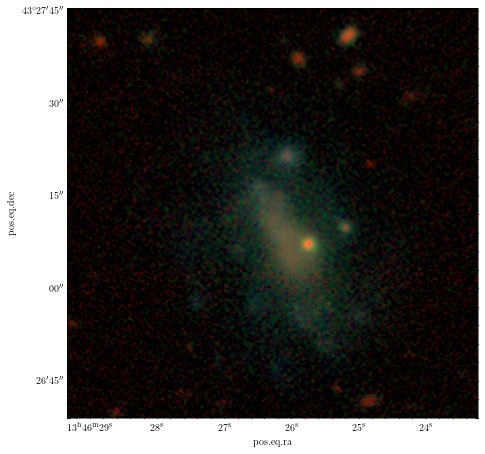

In [4]:
header, data = fetch_cutout(206.6094919340122, 43.45338288172203, pixscale=0.262)
wcs = WCS(header)[0]
image_rgb = make_lupton_rgb(data[2], data[1], data[0], stretch=0.1)  # indices 0,1,2 = grz

plt.subplots(subplot_kw={'projection': wcs}, figsize=(6, 6))
plt.imshow(image_rgb, origin='lower')
plt.show()

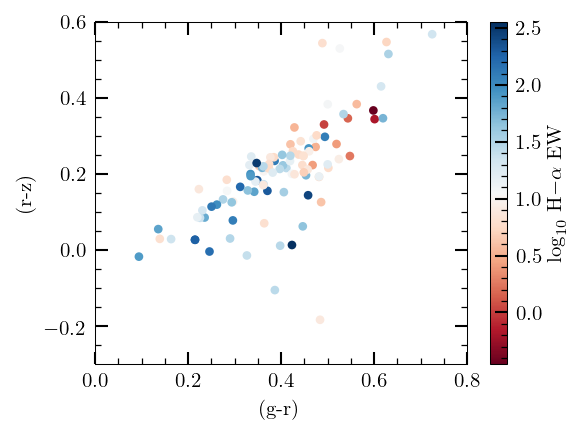

In [48]:
fig, axes = plt.subplots(dpi=150, figsize=(4, 3))
scat = axes.scatter(gr[EW>0],  rz[EW>0], c=np.log10(EW[EW>0]), s=10, cmap='RdBu')
cbar = plt.colorbar(scat)
cbar.ax.set_ylabel(r"$\log_{10}$ H$- \alpha$ EW")
axes.set(ylabel=r'(r-z)', xlabel='(g-r)', ylim=(-0.3, 0.6), xlim=(0., 0.8));

### From Brinchmann (2004), Section 5:

We calculate the colour of the galaxy outside the fibre by subtracting off the fibre magnitudes from the CMODEL (i.e. total) magnitudes and we convolve this with P(SFR/L$_i$|colour) to get an estimate of SFR/L$_i$ outside the fibre. We require that at least five galaxies contribute to the estimate of P(SFR/L$_i$|colour) in a given bin. For the bluest colours, there are bins where no empirical estimate of P(SFR/L$_i$|colour) exists, as few galaxies in the survey have very blue fibre colours. For these bins we use the closest bin. 

### From Salim 2007, page 274:

In order to obtain total SFRs, an aperture correction is
required. The total SFR is the sum of the SFR within the fiber and
outside of it. To estimate the SFR outside of the fiber, galaxies are
first divided into a color-color grid, based on their fiber colors.
Then, for each color cell, a distribution of i-band luminosity normalized
SFRs (SFR/Li) is constructed by adding up all galaxies of
SF or low-S/N SF class that fall within the given color cell. Then,
the color of a galaxy outside of fiber is used to select the appropriate
color cell, and the SFR/Li in that cell is usedwith the i-band
luminosity to derive the SFR outside of the fiber. This is added to
previously found SFR within the fiber to obtain the total SFR. In
other words, the aperture correction procedure is based on two assumptions.
First, that SFRs within fibers have the same depen-
18 dency on color as the SFR outside of it, and second, that this dependency, calibrated with star-forming galaxies, applies to other
galaxy classes. The aperture correction factors range from close
to one (no correction) to around a hundred fold. On average they
are 0.9 dex for the entire sample and 0.6 dex for the star-forming
class.


Procedure to estimate the SFR outside of the fiber:
------

1. Divide galaxies into a color-color grid, based on their fiber colors.
2. For each color cell: Construct a distribution of i-band luminosity normalized SFRs (SFR/L$_i$) by adding up all galaxies of SF or low-S/N SF class that fall within the given color cell.
3. Select the appropriate color cell using the color of a galaxy outside of fiber
4. Use the SFR/Li in that cell with the i-band luminosity to derive the SFR outside of the fiber. 


Nanomaggies:

http://www.sdss3.org/dr8/algorithms/magnitudes.php#nmgy


SAGA ctalog schema:
https://github.com/sagasurvey/saga/blob/master/SCHEMA.md

https://www.legacysurvey.org/viewer/cutout.fits?ra=20.328037330265207&dec=17.753904687006067&layer=ls-dr8&pixscale=0.26


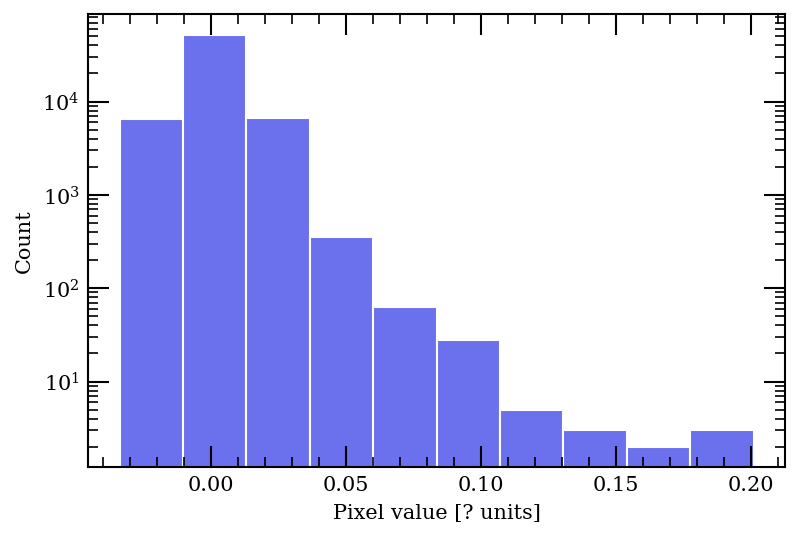

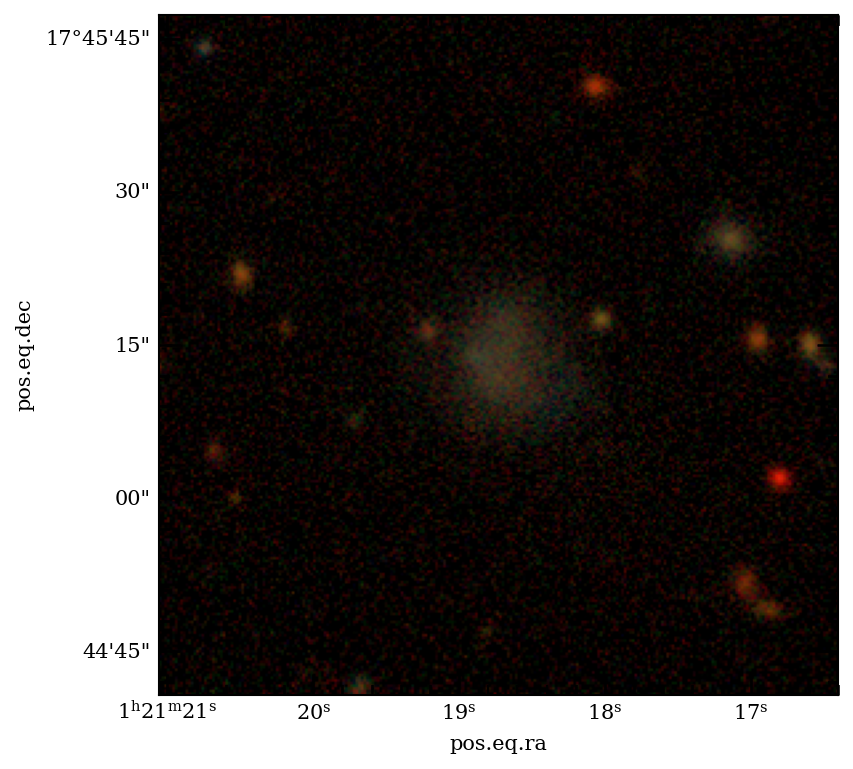

In [59]:
header, data = fetch_cutout(RA[0], DEC[0], pixscale=0.262)
fig, axes = plt.subplots(figsize=(6, 4), dpi=150)
axes.hist(data[2].flatten())
axes.set(yscale='log', xlabel='Pixel value [? units]', ylabel='Count')

image_rgb = make_lupton_rgb(data[2], data[1], data[0], stretch=0.1)  # indices 0,1,2 = grz

fig, axes = plt.subplots(subplot_kw={'projection': wcs}, figsize=(6, 6), dpi=150)
axes.imshow(image_rgb, origin='lower')


https://www.legacysurvey.org/viewer/cutout.fits?ra=20.777264094806608&dec=17.891556091834595&layer=ls-dr8&pixscale=1.00


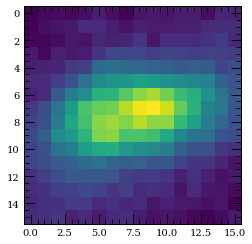

In [142]:
gal_idx = 4

header, data = fetch_cutout(RA[gal_idx], DEC[gal_idx], pixscale=1)
z_cut = return_cutout(data[2], radius[gal_idx], )
plt.imshow(z_cut)
z_mag = nanomaggies_to_Pogson_mag(sum(z_cut.flatten()))

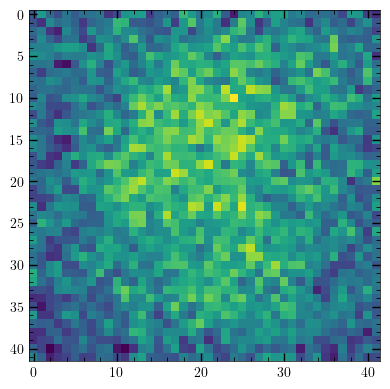

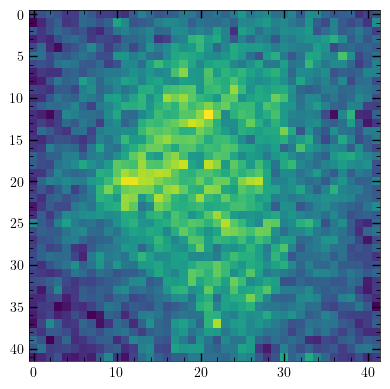

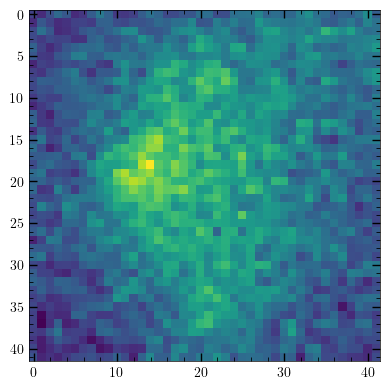

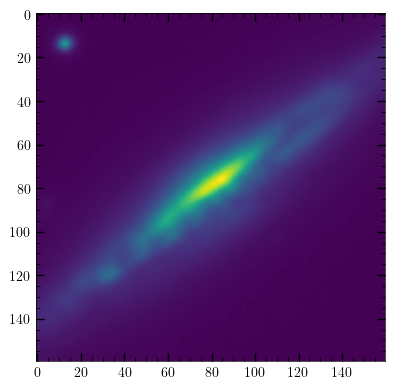

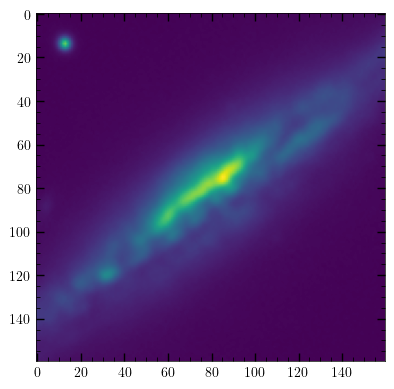

...

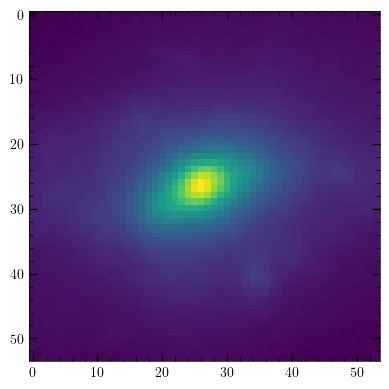

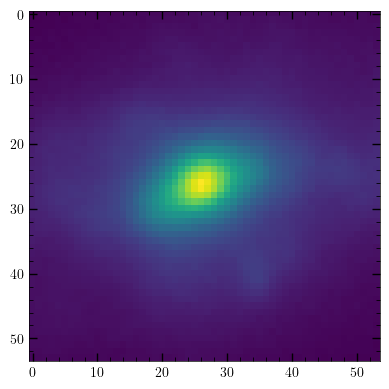

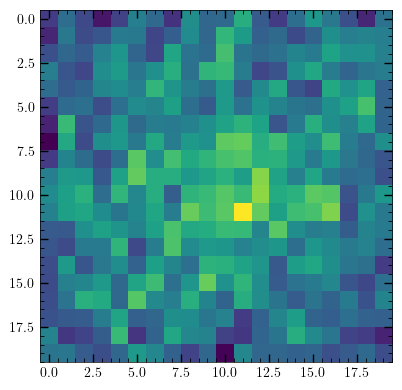

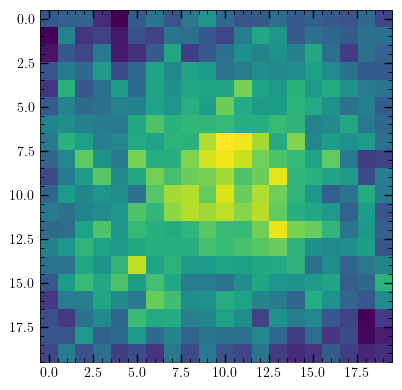

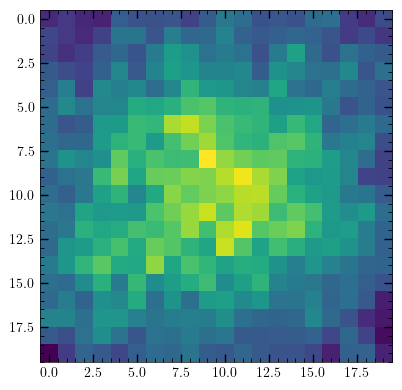

KeyboardInterrupt: 

In [7]:
z_diff = []
r_diff = []
g_diff = []
z_images = np.array([])
g_images = np.array([])
r_images = np.array([])
g_img = []
r_img = []
z_img = []

for gal_idx in range(len(RA)):
    header, data = fetch_cutout(RA[gal_idx], DEC[gal_idx], pixscale=0.262, layer="ls-dr9")

    z_cut = return_cutout(data[2], radius[gal_idx]/0.262 )
    fig, axes = plt.subplots(dpi=100)
    plt.imshow(z_cut)
    z_mag = nanomaggies_to_Pogson_mag(sum(z_cut.flatten()))
    if gal_idx==0:
        z_images = data[2]
    else:
        z_images = np.vstack([z_images, data[2]])
    diff = z_mag - z_mags[gal_idx]
    z_diff.append(diff)
    z_img.append(z_mag)

    r_cut = return_cutout(data[1], radius[gal_idx]/0.262 )
    fig, axes = plt.subplots(dpi=100)
    plt.imshow(r_cut)
    r_mag = nanomaggies_to_Pogson_mag(sum(r_cut.flatten()))
    if gal_idx==0:
        r_images = data[1]
    else:
        r_images = np.vstack([r_images, data[1]])
    diff = r_mag - r_mags[gal_idx]
    r_diff.append(diff)
    r_img.append(r_mag)

    g_cut = return_cutout(data[0], radius[gal_idx]/0.262 )
    fig, axes = plt.subplots(dpi=100)
    plt.imshow(g_cut)
    g_mag = nanomaggies_to_Pogson_mag(sum(g_cut.flatten()))
    if gal_idx==0:
        g_images = data[0]
    else:
        g_images = np.vstack([g_images, data[0]])
    diff = g_mag - g_mags[gal_idx]
    g_diff.append(diff)
    g_img.append(g_mag)
    plt.show()

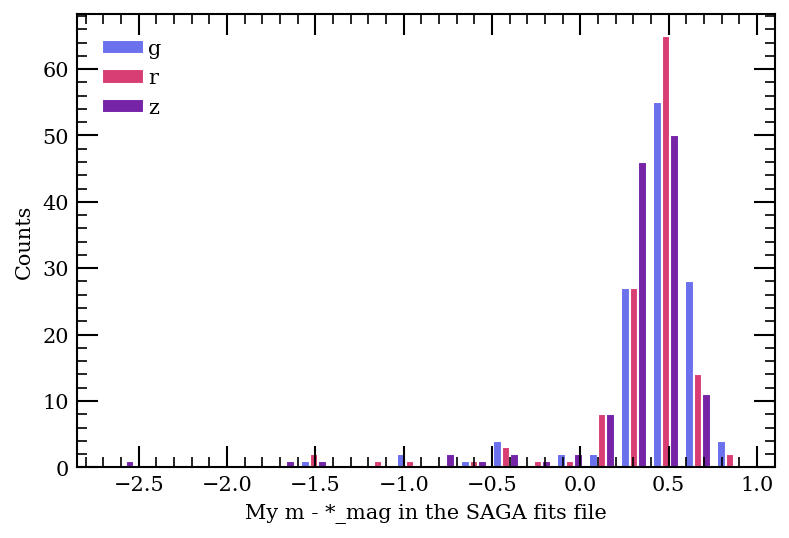

In [127]:
fig, axes = plt.subplots(figsize=(6, 4), dpi=150)
axes.hist([np.array(g_diff)[np.where(np.isfinite(g_diff))[0]], 
           np.array(r_diff)[np.where(np.isfinite(g_diff))[0]], 
           np.array(z_diff)[np.where(np.isfinite(g_diff))[0]]], 
          label=['g', 'r', 'z'], bins=20)
axes.set(xlabel="My m - *_mag in the SAGA fits file", ylabel='Counts')
axes.legend(loc='upper left')

In [145]:
z_images = z_images.reshape(126, 256, 256)
g_images = g_images.reshape(126, 256, 256)
r_images = r_images.reshape(126, 256, 256)

np.save("z_images.npy", z_images)
np.save("g_images.npy", g_images)
np.save("r_images.npy", r_images)
np.save("g_img.npy", g_img)
np.save("r_img.npy", r_img)
np.save("z_img.npy", z_img)

In [8]:
z_images = np.load("z_images.npy")
g_images = np.load("g_images.npy")
r_images = np.load("r_images.npy")
g_img = np.load("g_img.npy")
r_img = np.load("r_img.npy")
z_img = np.load("z_img.npy" )

## Examine bad magnitude calculations

[Text(0.5, 0, 'Radius in catalog ["]'), Text(0, 0.5, 'Counts')]

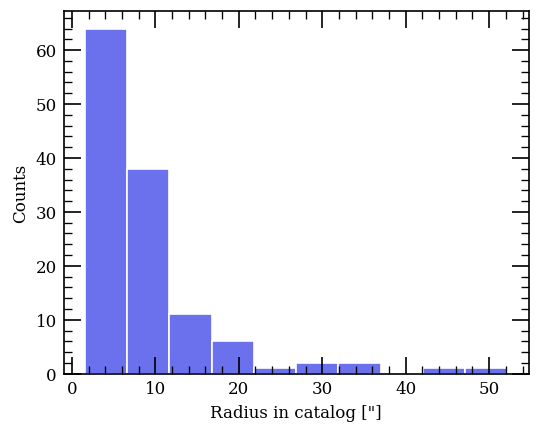

In [119]:
fig, axes = plt.subplots(figsize=(5,4), dpi=120)
axes.hist(radius)
axes.set(xlabel='Radius in catalog ["]', ylabel='Counts')


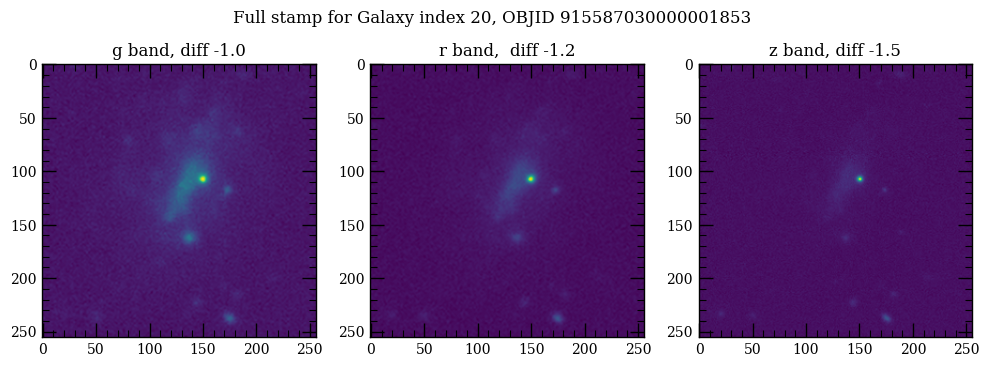

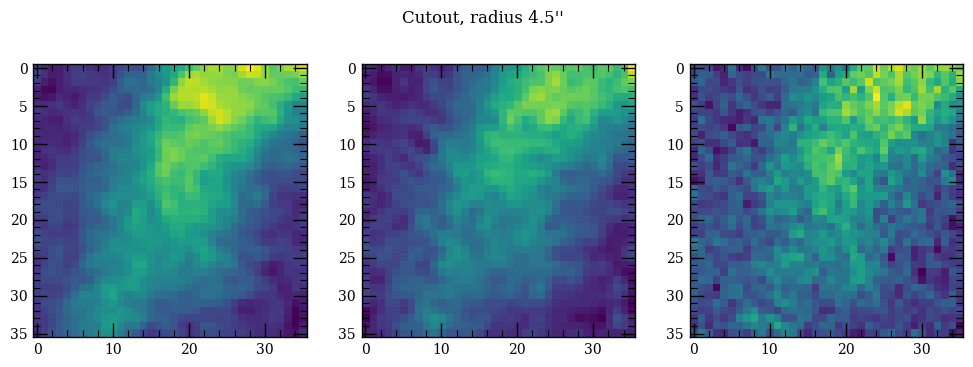

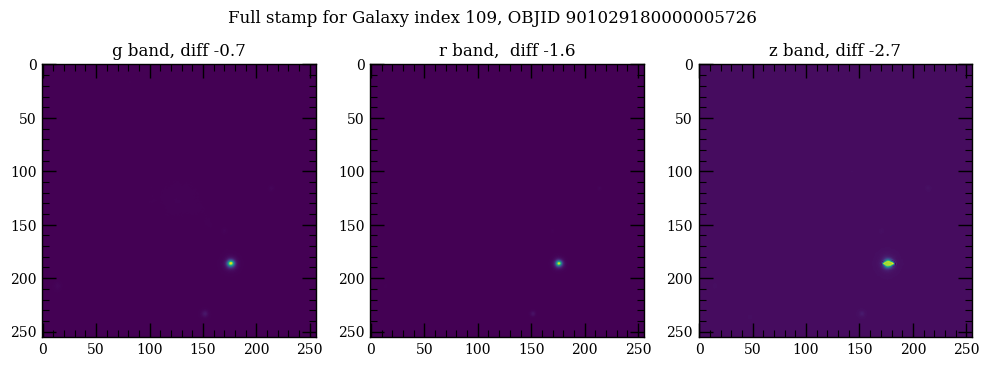

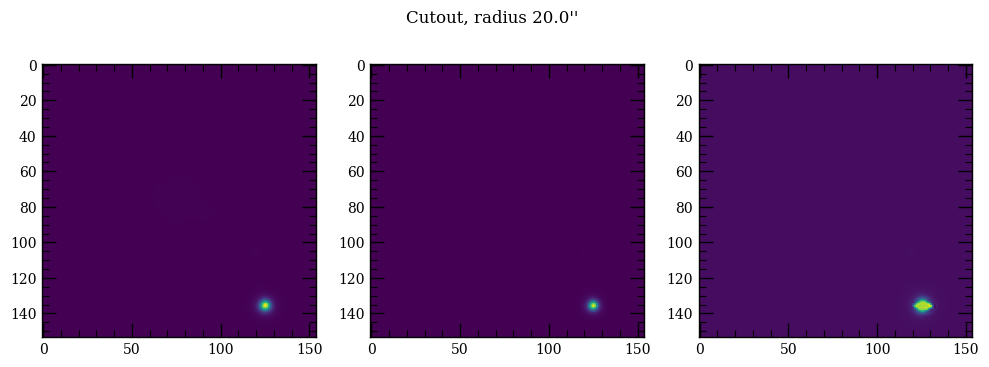

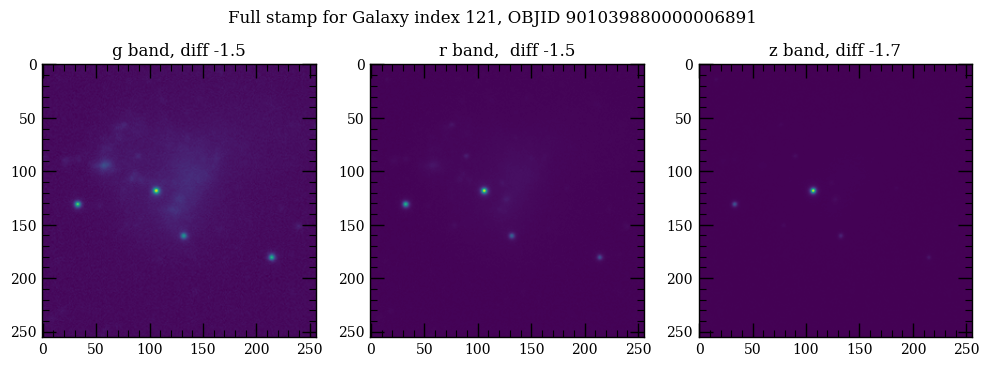

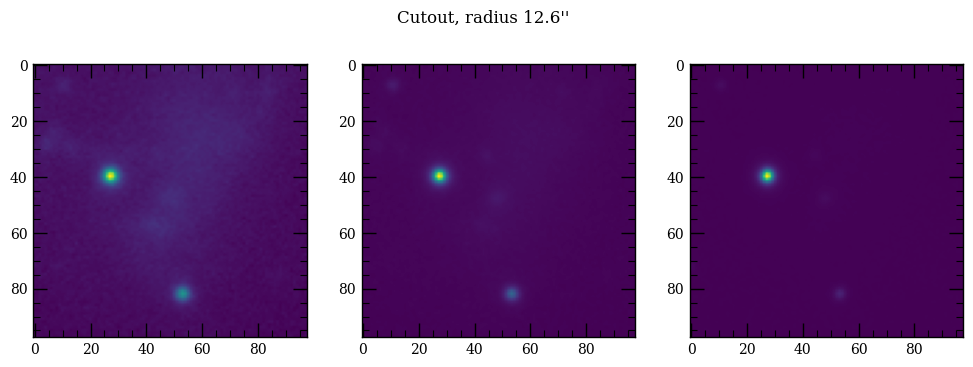

In [143]:
for concern_idx in z_concern_idx:
    fig, axes = plt.subplots(figsize=(12,4), dpi=100, ncols=3, nrows=1)
    axes[0].imshow(g_images[concern_idx])
    axes[0].set_title("g band, diff {0:0.1f}".format(g_diff[concern_idx]))
    axes[1].imshow(r_images[concern_idx])
    axes[1].set_title("r band,  diff {0:0.1f}".format(r_diff[concern_idx]))
    axes[2].imshow(z_images[concern_idx])
    axes[2].set_title("z band, diff {0:0.1f}".format(z_diff[concern_idx]))
    fig.suptitle(f"Full stamp for Galaxy index {concern_idx}, OBJID {cat['OBJID'][concern_idx]}")
    
    fig, axes = plt.subplots(figsize=(12,4), dpi=100, ncols=3, nrows=1)
    fig.suptitle(f"Cutout, radius {radius[concern_idx]:0.1f}''")
    g_cut = return_cutout(g_images[concern_idx], radius[concern_idx]/0.262 )
    axes[0].imshow(g_cut)
    
    r_cut = return_cutout(r_images[concern_idx], radius[concern_idx]/0.262 )
    axes[1].imshow(r_cut)
    
    z_cut = return_cutout(z_images[concern_idx], radius[concern_idx]/0.262 )
    axes[2].imshow(z_cut)
    print("============================================================================================================")
    print("============================================================================================================")
    plt.show()

Text(0.5, 0.98, 'Image colors')

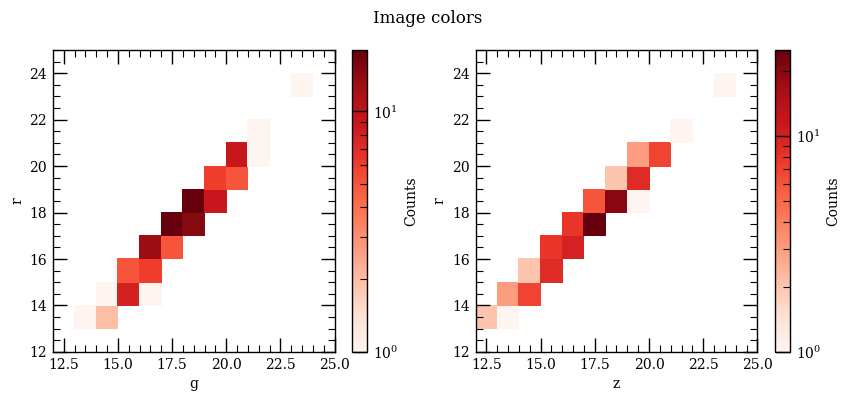

In [100]:
bins = np.arange(12, 26, step=1)
fig, axes = plt.subplots(figsize=(10,4), dpi=100, ncols=2)
histo_gr = axes[0].hist2d(g_img, r_img, cmap='Reds', norm=LogNorm(), bins=bins)

cbar = fig.colorbar(histo_gr[3], ax=axes[0])
axes[0].set(xlabel="g", ylabel='r')
cbar.ax.set_ylabel('Counts')
     
histo_zr = axes[1].hist2d(z_img, r_img, cmap='Reds', norm=LogNorm(), bins=bins)
cbar = fig.colorbar(histo_zr[3], ax=axes[1])
axes[1].set(xlabel="z", ylabel='r')
cbar.ax.set_ylabel('Counts')
fig.suptitle("Image colors")

In [88]:
bins = np.arange(12, 26, step=1)
fig, axes = plt.subplots(figsize=(10,4), dpi=100, ncols=2)
histo_gr = axes[0].hist2d(g_img, r_img, cmap='Reds', norm=LogNorm(), bins=bins)

cbar = fig.colorbar(histo_gr[3], ax=axes[0])
axes[0].set(xlabel="g", ylabel='r')
cbar.ax.set_ylabel('Counts')
     
histo_zr = axes[1].hist2d(z_img, r_img, cmap='Reds', norm=LogNorm(), bins=bins)
cbar = fig.colorbar(histo_zr[3], ax=axes[1])
axes[1].set(xlabel="z", ylabel='r')
cbar.ax.set_ylabel('Counts')
fig.suptitle("Image colors")

'\nhisto_zr = axes[1].hist2d( cmap=\'Reds\', norm=LogNorm(), bins=bins)\ncbar = fig.colorbar(histo_zr[3], ax=axes[1])\naxes[1].set(xlabel="z", ylabel=\'r\')\ncbar.ax.set_ylabel(\'Counts\')\nfig.suptitle("Image colors")'

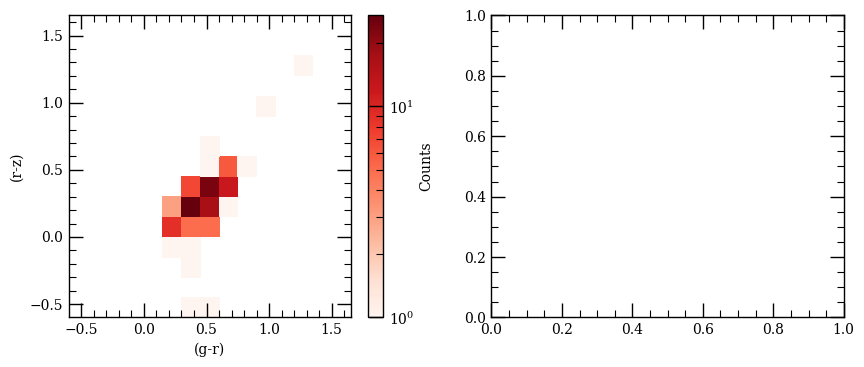

In [158]:
g_img = np.array(g_img)
r_img = np.array(r_img)
z_img = np.array(z_img)

bins = np.arange(-0.6, 1.8, step=0.15)
fig, axes = plt.subplots(figsize=(10,4), dpi=100, ncols=2)

histo_gr = axes[0].hist2d(g_img- r_img, r_img-z_img, cmap='Reds', norm=LogNorm() , bins=bins)

cbar = fig.colorbar(histo_gr[3], ax=axes[0])
axes[0].set(xlabel="(g-r)", ylabel='(r-z)')
cbar.ax.set_ylabel('Counts')
'''
histo_zr = axes[1].hist2d( cmap='Reds', norm=LogNorm(), bins=bins)
cbar = fig.colorbar(histo_zr[3], ax=axes[1])
axes[1].set(xlabel="z", ylabel='r')
cbar.ax.set_ylabel('Counts')
fig.suptitle("Image colors")'''

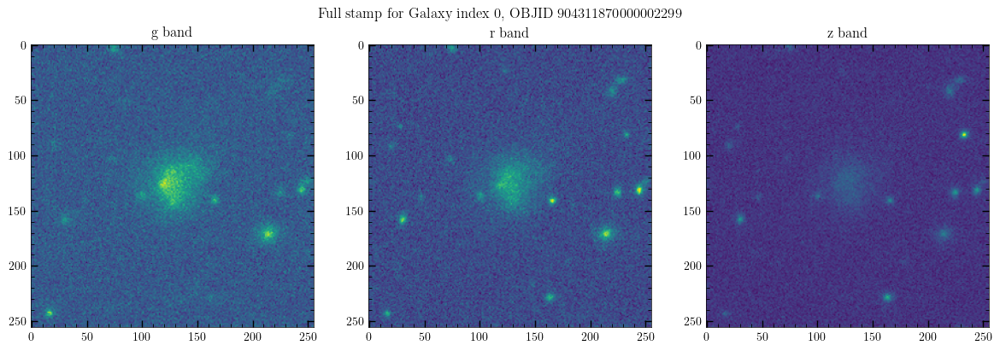

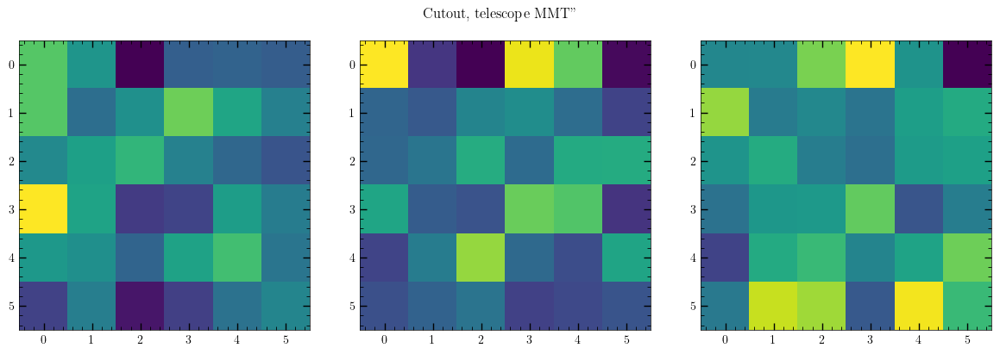

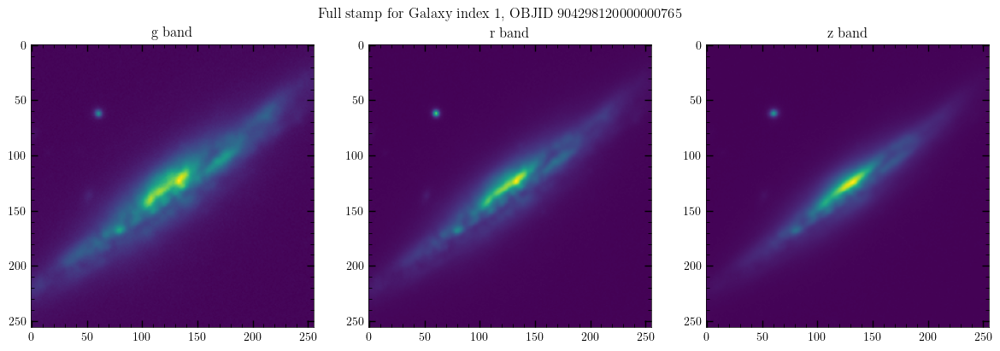

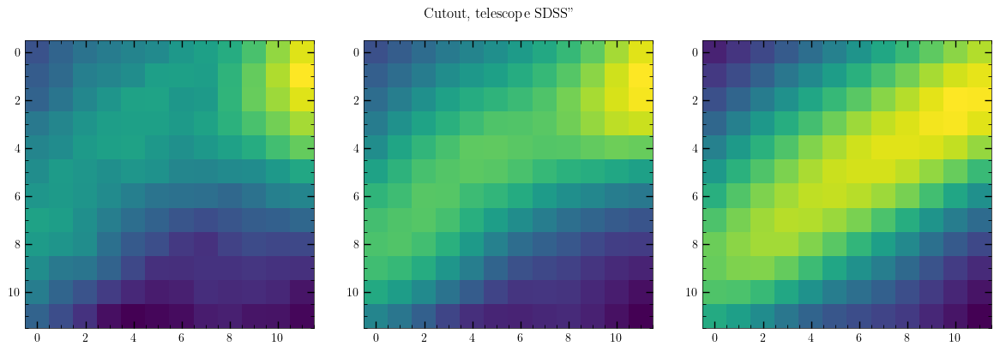

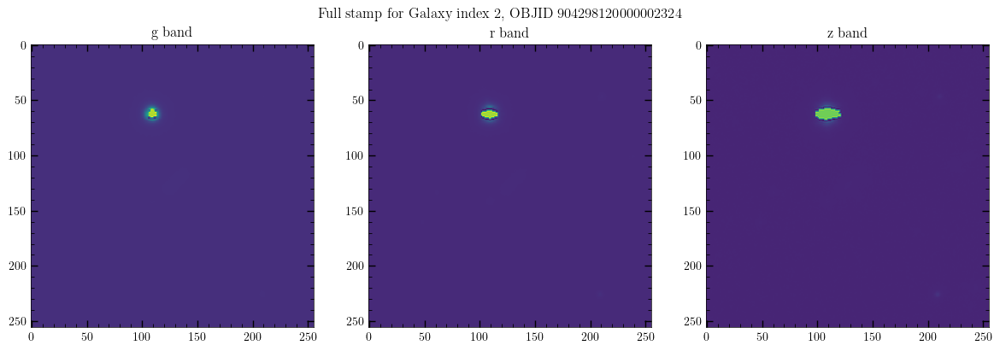

...

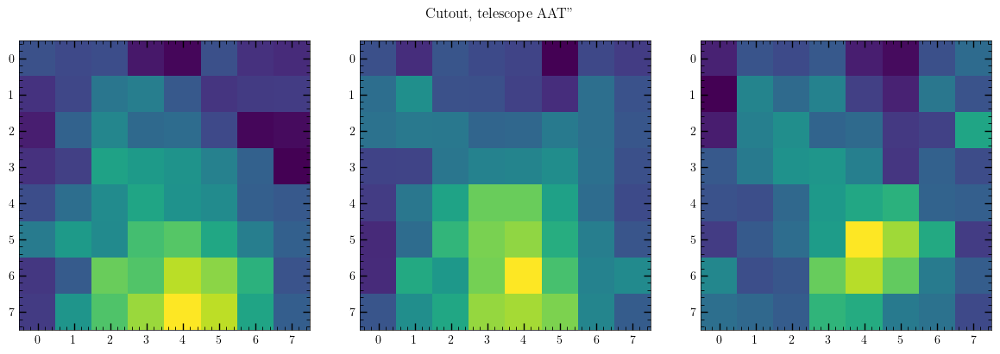

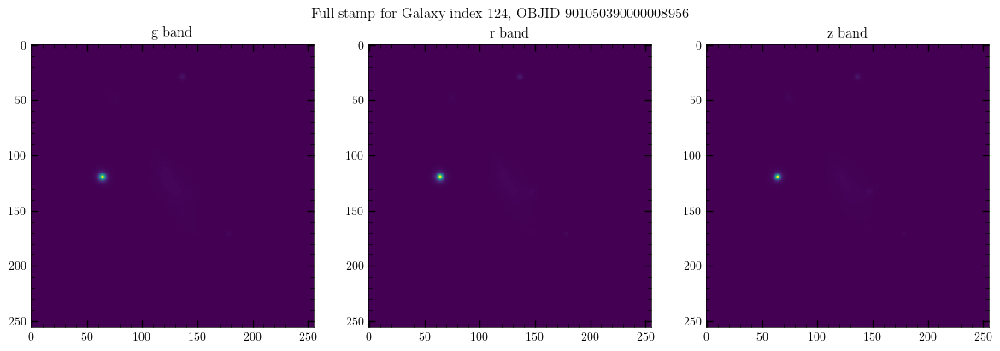

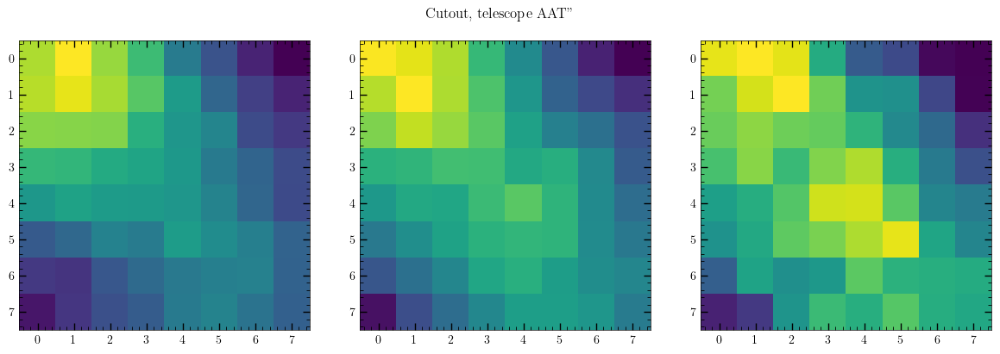

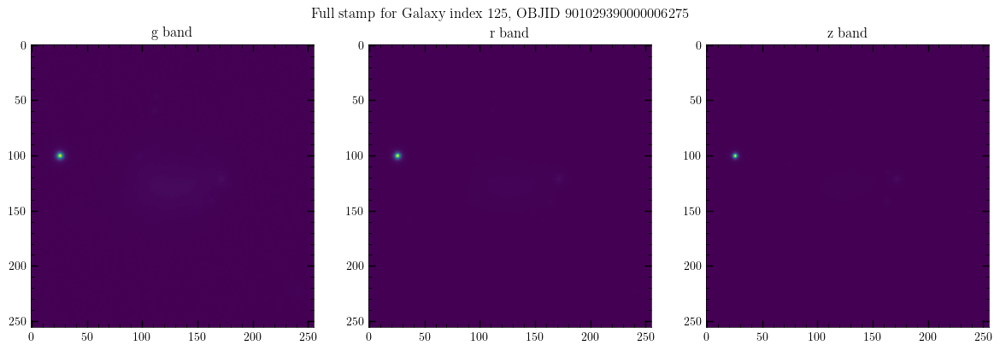

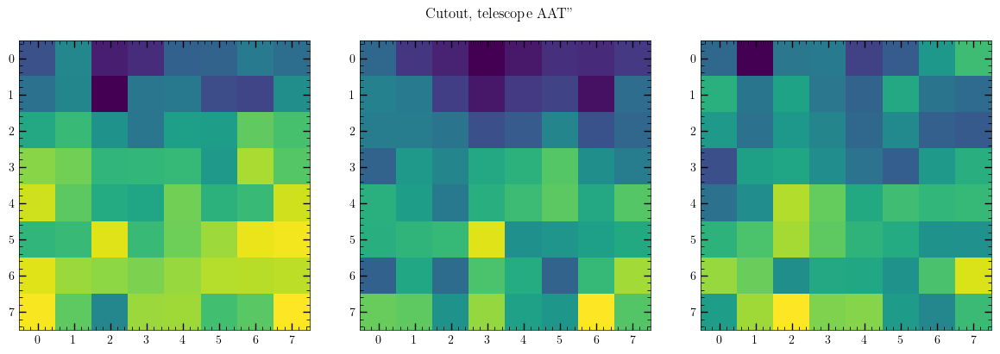

In [11]:
g_fiber = []
r_fiber = []
z_fiber = []
for gal_idx in range(len(RA)):
    header, data = fetch_cutout(RA[gal_idx], DEC[gal_idx], pixscale=0.262, layer="ls-dr9")
    
    fig, axes = plt.subplots(figsize=(12,4), dpi=100, ncols=3, nrows=1)
    axes[0].imshow(g_images[gal_idx])
    axes[0].set_title("g band")
    axes[1].imshow(r_images[gal_idx])
    axes[1].set_title("r band")
    axes[2].imshow(z_images[gal_idx])
    axes[2].set_title("z band")
    fig.suptitle(f"Full stamp for Galaxy index {gal_idx}, OBJID {cat['OBJID'][gal_idx]}")
    
    fig, axes = plt.subplots(figsize=(12,4), dpi=100, ncols=3, nrows=1)
    fig.suptitle(f"Cutout, telescope {telescopes[gal_idx]}''")
    g_cut = fiber_cutout(g_images[gal_idx], telescopes[gal_idx])
    axes[0].imshow(g_cut)
    g_mag = nanomaggies_to_Pogson_mag(sum(g_cut.flatten()))
    g_fiber.append(g_mag)
                 
    r_cut = fiber_cutout(r_images[gal_idx], telescopes[gal_idx])
    axes[1].imshow(r_cut)
    r_mag = nanomaggies_to_Pogson_mag(sum(r_cut.flatten()))
    r_fiber.append(r_mag)

    z_cut = fiber_cutout(z_images[gal_idx], telescopes[gal_idx])
    axes[2].imshow(z_cut)
    z_mag = nanomaggies_to_Pogson_mag(sum(z_cut.flatten()))
    z_fiber.append(z_mag)
    print("============================================================================================================")
    print("============================================================================================================")
    plt.show()

Text(0.5, 1.0, 'Fiber colors')

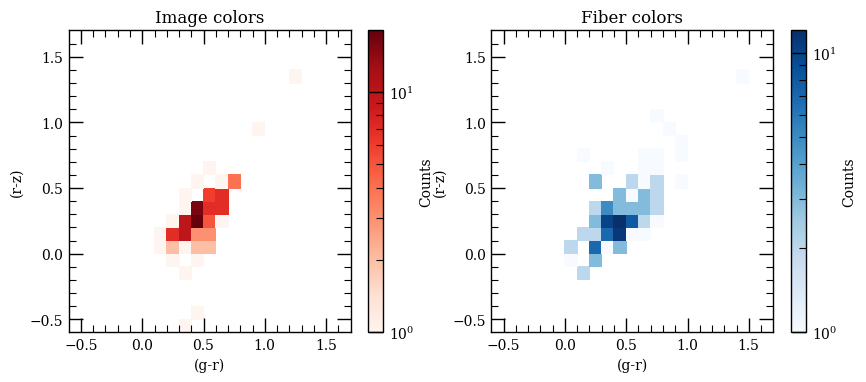

In [171]:
g_img = np.array(g_img)
r_img = np.array(r_img)
z_img = np.array(z_img)
g_fiber = np.array(g_fiber)
r_fiber = np.array(r_fiber)
z_fiber = np.array(z_fiber)

bins = np.arange(-0.6, 1.8, step=0.1)
fig, axes = plt.subplots(figsize=(10,4), dpi=100, ncols=2)

histo_img = axes[0].hist2d(g_img- r_img, r_img-z_img, cmap='Reds', norm=LogNorm() , bins=bins)

cbar = fig.colorbar(histo_img[3], ax=axes[0])
axes[0].set(xlabel="(g-r)", ylabel='(r-z)', title="Image colors")
cbar.ax.set_ylabel('Counts')

histo_fiber = axes[1].hist2d(g_fiber-r_fiber, r_fiber-z_fiber, cmap='Blues', norm=LogNorm(), bins=bins)
cbar = fig.colorbar(histo_fiber[3], ax=axes[1])
axes[1].set(xlabel="(g-r)", ylabel='(r-z)')
cbar.ax.set_ylabel('Counts')
axes[1].set_title("Fiber colors")

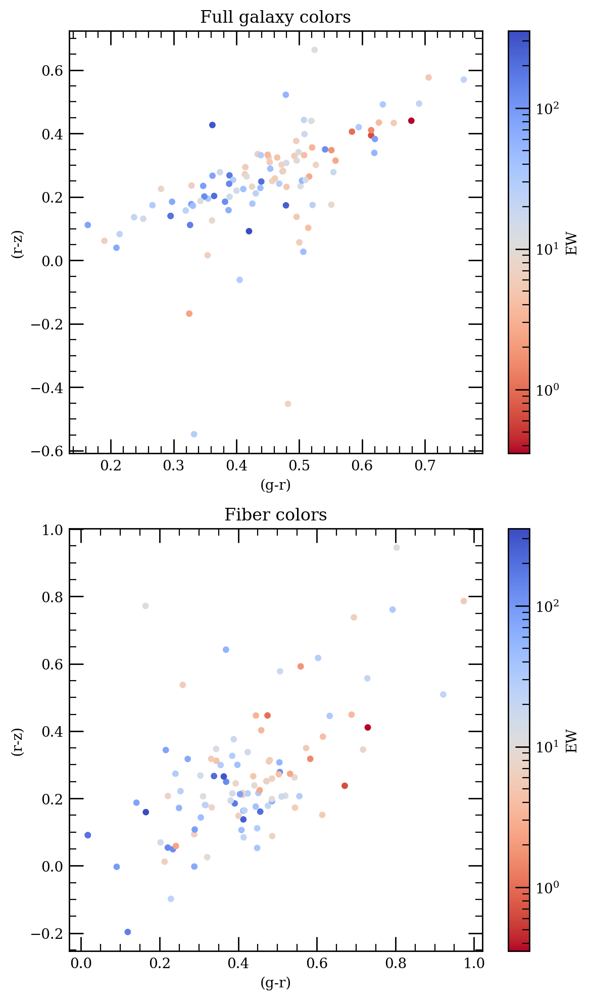

In [203]:
pos_EW = np.where(EW>=0)[0]
fig, axes = plt.subplots(figsize=(6,10), dpi=200, nrows=2)

img_scat = axes[0].scatter(g_img[pos_EW]- r_img[pos_EW], r_img[pos_EW]-z_img[pos_EW], s=13,
                           c=EW[pos_EW], norm=LogNorm(), cmap='coolwarm_r')

cbar = fig.colorbar(img_scat, ax=axes[0])
axes[0].set(xlabel="(g-r)", ylabel='(r-z)', title="Full galaxy colors")
cbar.ax.set_ylabel('EW')

fiber_scat = axes[1].scatter(g_fiber[pos_EW]-r_fiber[pos_EW], r_fiber[pos_EW]-z_fiber[pos_EW],
                             c=EW[pos_EW], s=13, norm=LogNorm(), cmap='coolwarm_r')
cbar = fig.colorbar(fiber_scat, ax=axes[1])
axes[1].set(xlabel="(g-r)", ylabel='(r-z)')
cbar.ax.set_ylabel('EW')
axes[1].set_title("Fiber colors")
plt.tight_layout()

## Fetch GALEX data

In [6]:
colnames = ['ObjID', 'GLXID', 'plate',
           'MJD', 'fiber ID', 'RA', 'Dec', 'z', 'chi_squared_r', "log M_star",
           "sigma(log M_star)", 'log SFR_SED', 'sigma(log SFR_SED)', 
            "A_FUV",  #Dust attenuation in rest-frame FUV
            "sigma(A_FUV)", 
            "A_B", # Dust attenuation in rest-frameB
            "sigma(A_B)",
            "A_V", "sigma(A_V)", "flag_sed", "UV survey",
            "log SFR_mid-IR, AW",  #Mid-IR star formation rate fromWISE(AllWISE catalog) in Msol/yr
            "flag_wise","log SFR_mid-IR, uW", # Mid-IR star formation rate fromWISE(unWISE catalog)
            "flag_unwise", "flag_mgs"
           ]

gswlc_a1 = np.genfromtxt("GSWLC-A1.dat")
gswlc = pd.DataFrame(data=gswlc_a1, columns=colnames)

gswlc

,ObjID,GLXID,plate,MJD,fiber ID,RA,Dec,z,chi_squared_r,log M_star,...,sigma(A_B),A_V,sigma(A_V),flag_sed,UV survey,"log SFR_mid-IR, AW",flag_wise,"log SFR_mid-IR, uW",flag_unwise,flag_mgs
0,1.237646e+18,-9.900000e+01,1242.0,52901.0,461.0,57.442293,0.158853,0.1593,0.90,11.563,...,0.105,0.161,0.071,0.0,1.0,-99.000,5.0,-99.000,5.0,1.0
1,1.237646e+18,-9.900000e+01,1242.0,52901.0,479.0,57.452672,0.044341,0.1351,0.98,10.816,...,0.214,0.271,0.138,0.0,1.0,1.331,0.0,1.364,0.0,1.0
2,1.237646e+18,-9.900000e+01,1242.0,52901.0,487.0,57.490415,0.074355,0.1316,1.30,11.379,...,0.089,0.253,0.063,0.0,1.0,-99.000,5.0,-99.000,5.0,1.0
3,1.237646e+18,-9.900000e+01,1242.0,52901.0,491.0,57.508919,0.066566,0.1314,0.04,11.204,...,0.235,0.409,0.166,0.0,1.0,-99.000,5.0,-99.000,5.0,1.0
4,1.237646e+18,6.377143e+18,1242.0,52901.0,493.0,57.507462,0.027608,0.1319,0.16,10.494,...,0.208,0.367,0.153,0.0,1.0,-99.000,5.0,-99.000,5.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640654,1.237680e+18,-9.900000e+01,5023.0,55858.0,386.0,333.471980,19.074534,0.1743,0.30,11.260,...,0.139,0.166,0.091,0.0,1.0,-99.000,5.0,-99.000,5.0,0.0
640655,1.237680e+18,6.372323e+18,5964.0,56098.0,894.0,329.091270,28.048249,0.0958,0.82,11.034,...,0.108,0.177,0.074,0.0,1.0,-99.000,5.0,-99.000,5.0,0.0
640656,1.237680e+18,-9.900000e+01,5964.0,56098.0,386.0,327.703640,27.569175,0.2600,0.87,11.669,...,0.088,0.218,0.062,0.0,1.0,-99.000,5.0,-99.000,5.0,0.0
640657,1.237680e+18,-9.900000e+01,5964.0,56098.0,934.0,329.209590,28.112582,0.0697,0.17,10.651,...,0.138,0.267,0.093,0.0,1.0,-99.000,5.0,-99.000,5.0,0.0


In [7]:
galex_RA = gswlc['RA'].values
galex_Dec = gswlc['Dec'].values
SFRuw = gswlc['log SFR_mid-IR, uW'].values

# Read in NASA SDSS Atlas

In [8]:
nsatlas = fits.getdata("nsa_v0_1_2.fits")

In [9]:
nsaRA = nsatlas['RA'].copy()
nsaDec = nsatlas['DEC'].copy()
nsaHAEW = nsatlas['HAEW'].copy()
nsaPETROTH50 = nsatlas['PETROTH50'].copy()
nsaMAG = nsatlas['MAG'].copy()
nsaRBANDNMGY = nsatlas['NMGY'][:,4].copy()
nsaZDIST = nsatlas['ZDIST'].copy()
nsaRBANDABSMAG = nsatlas['ABSMAG'][:,4].copy()

# Match GSWLC to NASA SDSS Atlas

In [10]:
NSAcoord = SkyCoord(ra=nsaRA*u.degree, dec=nsaDec*u.degree)
GALEXcoord = SkyCoord(ra=galex_RA*u.degree, dec=galex_Dec*u.degree)
idx, d2d, d3d = NSAcoord.match_to_catalog_sky(GALEXcoord)


close_idx = np.where(d2d.to(u.arcsec)<2*u.arcsec)[0]
print(len(close_idx))
print(len(idx))

map_galex_to_nsa = idx[close_idx]

95209
145155


In [11]:
nsaRBAND = np.array([nanomaggies_to_Pogson_mag(nmgy) for nmgy in nsaRBANDNMGY])

In [12]:
selected_SFR = gswlc['log SFR_SED'][map_galex_to_nsa]
selected_HAEW =  nsaHAEW[close_idx]
selected_RA = nsaRA[close_idx]
selected_DEC = nsaDec[close_idx]
selected_PETROTH50 = nsaPETROTH50[close_idx]
selected_MAG = nsaMAG[close_idx]
selected_RBAND = nsaRBAND[close_idx]
selected_ZDIST = nsaZDIST[close_idx]
selected_RBANDABSMAG = nsaRBANDABSMAG[close_idx]



In [13]:
has_measurements = np.where((selected_HAEW>-500.) & 
    (selected_SFR>-80.) & (selected_RBANDABSMAG>-17.5) )[0]

complete_SFR =  np.take(selected_SFR.values, has_measurements)
complete_HAEW = np.take(selected_HAEW, has_measurements)
complete_RA =   np.take(selected_RA, has_measurements)
complete_DEC =  np.take(selected_DEC, has_measurements)
complete_PETROTH50 = np.take(selected_PETROTH50, has_measurements)
complete_RBANDABSMAG = np.take(selected_RBANDABSMAG, has_measurements)
complete_ZDIST = np.take(selected_ZDIST, has_measurements)

[Text(0.5, 0, 'H-$\\alpha$ equivalent width'),
 Text(0, 0.5, 'log SFR$_{\\mathrm{SED}}$ from GSWLC $[M_\\odot$ yr$^{-1}$]')]

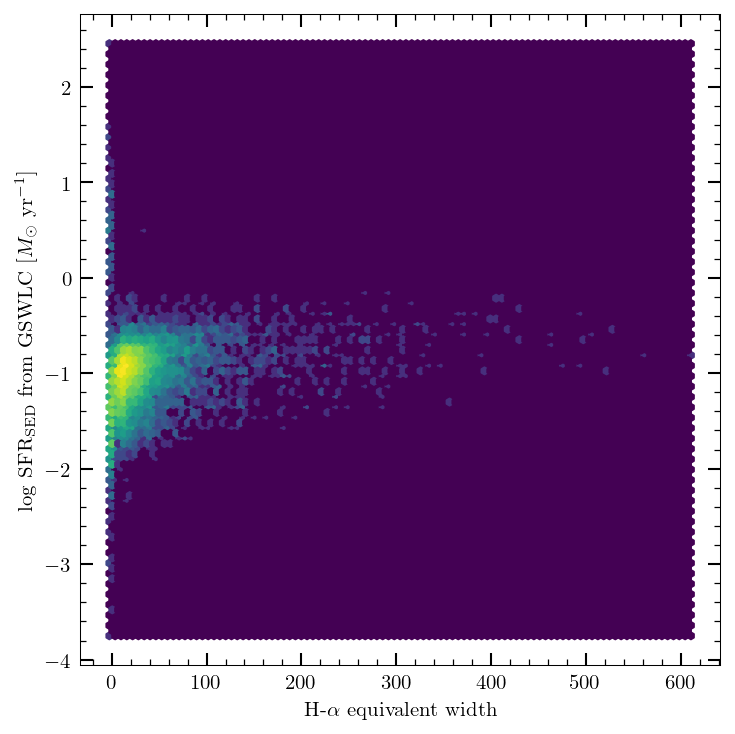

In [15]:
fig, axes = plt.subplots(figsize=(5,5), dpi=150)
axes.hexbin(complete_HAEW, complete_SFR, 
            bins='log',# xscale='log'
           )
axes.set(xlabel=r"H-$\alpha$ equivalent width",
         ylabel=r'log SFR$_{\mathrm{SED}}$ from GSWLC $[M_\odot$ yr$^{-1}$]')


# Save training dataset into NN-ready format

In [ ]:
# photos = []
# matched_SFRs = []
for ii in range(3405, len(complete_RA)):
    photos.append(gather_photometry(complete_RA[ii], 
                                             complete_DEC[ii],
                                             complete_PETROTH50[ii], 
                                             'NSA', 
                                             complete_ZDIST[ii], 
                                             complete_RBANDABSMAG[ii],
                                             halpha=complete_HAEW[ii]))
    matched_SFRs.append(complete_SFR[ii])
    if ii%75==1:
        np.save("photometric_data_with_z.npy", photos)
        np.save("sfr_data_synced_to_photo_dictionary_with_z.npy", matched_SFRs)
        print(ii, "saved")


3451 saved
3526 saved
3601 saved
3676 saved
3751 saved
3826 saved
3901 saved
3976 saved
4051 saved
4126 saved
4201 saved
4276 saved


In [57]:
for b in range(1, 18):
    photos_new = np.array([gather_photometry(complete_RA[ii], complete_DEC[ii],
                            complete_PETROTH50[ii], 'NSA', halpha=complete_HAEW[ii])
         for ii in range(b*75, (b+1)*75)])
    photos = np.vstack([photos, photos_new])
    matched_SFRs = np.hstack([matched_SFRs, complete_SFR[b*75:(b+1)*75].values])
    print("stacked")
    np.save("photometric_data.npy", photos)
    np.save("sfr_data_synced_to_photo_dictionary.npy", matched_SFRs)
    
for b in range(19, 50):
    photos_new = np.array([gather_photometry(complete_RA[ii], complete_DEC[ii],
                            complete_PETROTH50[ii], 'NSA', halpha=complete_HAEW[ii])
         for ii in range(b*75, (b+1)*75)])
    photos = np.vstack([photos, photos_new])
    matched_SFRs = np.hstack([matched_SFRs, complete_SFR[b*75:(b+1)*75].values])
    print("stacked")
    np.save("photometric_data.npy", photos)
    np.save("sfr_data_synced_to_photo_dictionary.npy", matched_SFRs)

stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked
stacked


HTTPError: HTTP Error 500: Internal Server Error

In [213]:
current_sfr_array = complete_SFR[:(b)*75]
print(len(current_sfr_array))
np.save("sfr_data_synced_to_photo_dictionary.npy", current_sfr_array)

450


In [189]:
photodf = pd.DataFrame(photos, columns=['fiber_g_mag', 'full_g_mag',
                                        'fiber_r_mag', 'full_r_mag',
                                        'fiber_z_mag', 'full_z_mag',
                                        'fiber_nuv_mag', 'full_nuv_mag',
                                        'fiber_fuv_mag', 'full_fuv_mag',
                                        'g_r_fiber', 'g_r_full',
                                        'r_z_fiber', 'r_z_full',
                                        'fuv_nuv_fiber', 'fuv_nuv_full', 
                                        'full_g_mag', 'full_r_mag', 'full_z_mag',
                                        'fiber_g_mag', 'fiber_r_mag', 'fiber_z_mag',
                                        'full_nuv_mag', 'full_fuv_mag',
                                        'fiber_nuv_mag', 'fiber_nuv_mag','halpha'])


In [190]:
photodf

,fiber_g_mag,full_g_mag,fiber_r_mag,full_r_mag,fiber_z_mag,full_z_mag,fiber_nuv_mag,full_nuv_mag,fiber_fuv_mag,full_fuv_mag,g_r_fiber,g_r_full,r_z_fiber,r_z_full,fuv_nuv_fiber,fuv_nuv_full,halpha,radius
0,20.630505,20.630505,20.072167,20.072167,19.592112,19.592112,22.856167,22.856167,24.027126,24.027126,0.558338,0.558338,0.480055,0.480055,1.170959,1.170959,21.083307,2.289765
1,21.055134,20.527209,20.459412,19.929611,20.145202,19.625306,23.416416,22.795154,24.905366,24.351031,0.595722,0.067797,0.314210,0.304305,1.488950,1.555877,38.808548,3.821622
2,21.417541,20.262839,20.548975,19.422085,19.852283,18.770072,24.532448,23.213055,26.663405,25.484405,0.868565,-0.286136,0.696693,0.652013,2.130957,2.271350,16.460962,5.329020
3,20.525722,20.525722,19.407658,19.407658,18.345308,18.345308,25.205080,25.205080,26.671650,26.671650,1.118064,1.118064,1.062350,1.062350,1.466570,1.466570,7.550173,2.982092
4,19.643996,19.643996,18.630520,18.630520,17.745149,17.745149,24.311589,24.311589,26.510112,26.510112,1.013476,1.013476,0.885371,0.885371,2.198523,2.198523,45.684097,2.278736
5,20.500139,20.500139,19.702110,19.702110,18.927250,18.927250,23.458607,23.458607,25.383207,25.383207,0.798029,0.798029,0.774859,0.774859,1.924600,1.924600,43.767979,2.267761
6,20.604011,20.604011,19.727749,19.727749,19.018479,19.018479,24.584720,24.584720,25.635837,25.635837,0.876262,0.876262,0.709270,0.709270,1.051118,1.051118,15.565465,2.235150
7,20.461774,19.957197,20.026786,19.508849,19.608654,19.126342,22.093004,21.504234,23.482619,22.889133,0.434989,-0.069589,0.418132,0.382507,1.389615,1.384898,9.844518,3.493677
8,20.340466,20.340466,19.461108,19.461108,18.610620,18.610620,23.730422,23.730422,25.655804,25.655804,0.879357,0.879357,0.850488,0.850488,1.925382,1.925382,14.201394,2.859202
9,19.599297,20.329289,18.459967,19.161549,17.359528,17.909289,26.763849,27.864011,NaN,NaN,1.139330,1.869323,1.100439,1.252260,NaN,NaN,1.363638,1.519010


# Save SAGA galaxies into NN-ready format

In [49]:
saga_abs_r = []
for index in range(len(r_mags)):
    apparent_mag = r_mags[index]
    luminosity_dist = compute_luminosity_distance(speczs[index])
    saga_abs_r.append(apparent_to_absolute(apparent_mag, luminosity_dist))

In [50]:
saga_photos = np.array([gather_photometry(RA[ii], DEC[ii],
                            radius[ii], telescopes[ii], speczs[ii], saga_abs_r[ii],  EW[ii]) for ii in range(len(RA))
                       ])
print("stacked")

stacked


In [51]:
np.save("SAGA_sats_photometric_data.npy", saga_photos)

In [159]:
sagaphotodf = pd.DataFrame(saga_photos, columns=['fiber_g_mag', 'full_g_mag',
                     'fiber_r_mag', 'full_r_mag',
                     'fiber_z_mag', 'full_z_mag',
                     'fiber_nuv_mag', 'full_nuv_mag',
                     'fiber_fuv_mag', 'full_fuv_mag',
                     'halpha',
                      'g_r_fiber', 'g_r_full',
                      'r_z_fiber', 'r_z_full',
                      'fuv_nuv_fiber', 'fuv_nuv_full'])

In [160]:
sagaphotodf

,fiber_g_mag,full_g_mag,fiber_r_mag,full_r_mag,fiber_z_mag,full_z_mag,fiber_nuv_mag,full_nuv_mag,fiber_fuv_mag,full_fuv_mag,halpha,g_r_fiber,g_r_full,r_z_fiber,r_z_full,fuv_nuv_fiber,fuv_nuv_full
0,23.856335,21.521304,23.400267,21.055906,23.239428,20.852333,25.835010,23.280228,26.098799,23.783058,204.2449,0.456068,-1.878963,0.160839,0.203573,0.263788,0.502830
1,23.005058,19.325949,22.551156,18.886288,22.313914,18.637829,24.897453,20.263250,25.274381,21.683261,-99.0000,0.453902,-3.225207,0.237243,0.248458,0.376929,1.420011
2,23.856335,23.856335,23.400267,23.400267,23.239428,23.239428,25.835010,25.835010,26.098799,26.098799,64.7340,0.456068,0.456068,0.160839,0.160839,0.263788,0.263788
3,23.856335,20.161358,23.400267,19.705740,23.239428,19.470750,25.835010,21.967613,26.098799,22.154244,5.8184,0.456068,-3.238908,0.160839,0.234990,0.263788,0.186632
4,23.856335,20.904255,23.400267,20.473864,23.239428,20.256139,25.835010,22.729955,26.098799,23.037708,32.5033,0.456068,-2.496011,0.160839,0.217725,0.263788,0.307753
5,23.856335,23.005058,23.400267,22.551156,23.239428,22.313914,25.835010,24.897453,26.098799,25.274381,22.6741,0.456068,-0.395208,0.160839,0.237243,0.263788,0.376929
6,23.856335,22.403619,23.400267,21.934819,23.239428,21.704691,25.835010,24.216213,26.098799,24.689863,28.2871,0.456068,-0.996648,0.160839,0.230128,0.263788,0.473649
7,23.856335,21.906420,23.400267,21.441576,23.239428,21.222380,25.835010,23.689454,26.098799,24.211335,-1.2270,0.456068,-1.493846,0.160839,0.219196,0.263788,0.521881
8,23.856335,22.403619,23.400267,21.934819,23.239428,21.704691,25.835010,24.216213,26.098799,24.689863,17.2536,0.456068,-0.996648,0.160839,0.230128,0.263788,0.473649
9,23.856335,18.827828,23.400267,18.372509,23.239428,18.114378,25.835010,19.675184,26.098799,21.092813,4.0188,0.456068,-4.572439,0.160839,0.258132,0.263788,1.417629


In [15]:
sdss_photo_data = np.load("photometric_data_with_z.npy")
ground_truth_sfrs = np.load("sfr_data_synced_to_photo_dictionary_with_z.npy")
saga_photo_data = np.load("SAGA_sats_photometric_data.npy")

In [16]:
# Turn the input photometric data into a pandas DataFrame with the corresponding column names

photodf = pd.DataFrame(sdss_photo_data, columns=['fiber_g_mag', 'full_g_mag',
                                        'fiber_r_mag', 'full_r_mag',
                                        'fiber_z_mag', 'full_z_mag',
                                        'fiber_nuv_mag', 'full_nuv_mag',
                                        'fiber_fuv_mag', 'full_fuv_mag',
                                        'g_r_fiber', 'g_r_full',
                                        'r_z_fiber', 'r_z_full',
                                        'fuv_nuv_fiber', 'fuv_nuv_full','rband', 'z','halpha_pos', 'halpha_neg'])
saga_df = pd.DataFrame(saga_photo_data, columns=['fiber_g_mag', 'full_g_mag',
                                        'fiber_r_mag', 'full_r_mag',
                                        'fiber_z_mag', 'full_z_mag',
                                        'fiber_nuv_mag', 'full_nuv_mag',
                                        'fiber_fuv_mag', 'full_fuv_mag',
                                        'g_r_fiber', 'g_r_full',
                                        'r_z_fiber', 'r_z_full',
                                        'fuv_nuv_fiber', 'fuv_nuv_full',  'halpha_pos', 'halpha_neg'])
# Take and store a log value of H-alpha for optimal model training
photodf['halpha_pos'] = np.log10(photodf['halpha_pos'].values)
photodf['halpha_neg'] = np.log10(photodf['halpha_neg'].values)
# Take and store a log value of H-alpha for optimal model training
saga_df['halpha_pos'] = np.log10(saga_df['halpha_pos'].values)
saga_df['halpha_neg'] = np.log10(saga_df['halpha_neg'].values)
# Add the star formation rate column temporarily while we go through data cleaning
photodf['SFR'] = ground_truth_sfrs

# Take a look to make sure there are no surprises
photodf

/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in log10
/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in log10
/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in log10


,fiber_g_mag,full_g_mag,fiber_r_mag,full_r_mag,fiber_z_mag,full_z_mag,fiber_nuv_mag,full_nuv_mag,fiber_fuv_mag,full_fuv_mag,...,g_r_full,r_z_fiber,r_z_full,fuv_nuv_fiber,fuv_nuv_full,rband,z,halpha_pos,halpha_neg,SFR
0,19.875634,20.527209,19.280281,19.929611,18.961168,19.625306,21.952400,22.795154,23.650975,24.351031,...,1.246928,0.319113,0.304305,1.698575,1.555877,-16.589527,0.021350,1.588927,-22.0,-1.084
1,19.575449,20.604011,18.700386,19.727749,18.031472,19.018479,23.255323,24.584720,24.544293,25.635837,...,1.903625,0.668914,0.709270,1.288970,1.051118,-16.561733,0.021049,1.192162,-22.0,-1.274
2,18.656964,18.901711,18.192876,18.459833,17.906833,18.196509,21.160206,21.519196,22.860684,23.206856,...,0.708835,0.286043,0.263324,1.700478,1.687660,-16.675308,0.011782,2.323727,-22.0,-1.056
3,19.250799,20.400557,18.499912,19.615961,17.940470,19.023605,22.548661,24.102551,24.479397,26.046618,...,1.900646,0.559442,0.592356,1.930735,1.944067,-17.359554,0.025707,1.261685,-22.0,-0.829
4,20.384443,20.686785,19.634529,19.928174,19.100941,19.382613,23.131709,23.557883,24.291668,24.639711,...,1.052256,0.533588,0.545561,1.159958,1.081828,-17.135136,0.026598,0.969241,-22.0,-0.962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4267,19.761693,19.500531,18.876803,18.642642,18.482326,18.243521,23.103041,22.817330,25.252348,24.990101,...,0.623728,0.394477,0.399120,2.149307,2.172771,-16.170902,0.010900,-0.318267,-22.0,-1.967
4268,19.031822,18.529316,18.341400,17.844406,17.911094,17.423245,20.350225,19.748008,21.894388,21.272551,...,0.187917,0.430305,0.421161,1.544163,1.524543,-17.144087,0.010807,1.074613,-22.0,-0.505
4269,18.500518,17.805469,17.928156,17.275521,17.771039,17.075005,19.576613,18.676154,21.096564,20.231049,...,-0.122687,0.157116,0.200516,1.519952,1.554894,-17.322712,0.010634,2.465410,-22.0,-0.153
4270,19.444015,18.374819,18.768858,17.740579,18.394568,17.427237,20.966527,19.704082,22.660938,21.291699,...,-0.394039,0.374289,0.313342,1.694411,1.587617,-17.432831,0.012789,0.743450,-22.0,-1.222


In [17]:
for index in range(50):
    sfr1 = log_SFR_from_FUV(photodf['full_fuv_mag'][index], photodf['z'][index])
    sfr2 = log_SFR_from_NUV(photodf['full_nuv_mag'][index], photodf['z'][index])
    print(sfr1, sfr2, photodf['SFR'][index])

abs mag -15.808788035754354
np.log10(lum) 10.144305350279646
abs mag -15.73710097397138
np.log10(lum) 7.259630525566456
0.6343053502796465 -2.0703694744335444 -1.084
abs mag -15.833229412465453
np.log10(lum) 10.154081900964087
abs mag -15.787773800593826
np.log10(lum) 7.279899656215434
0.6440819009640872 -2.0501003437845657 -1.274
abs mag -14.449961015770995
np.log10(lum) 9.600774542286302
abs mag -14.367985354283554
np.log10(lum) 6.711984277691325
0.09077454228630266 -2.618015722308675 -1.056
abs mag -16.292190450957694
np.log10(lum) 10.337666316360982
abs mag -16.207969609765676
np.log10(lum) 7.4479779798841745
0.8276663163609825 -1.8820220201158255 -0.829
abs mag -16.307373541041308
np.log10(lum) 10.343739552394428
abs mag -16.258625166160424
np.log10(lum) 7.4682402024420735
0.8337395523944284 -1.8617597975579265 -0.962
abs mag -15.545343033273713
np.log10(lum) 10.038927349287391
abs mag -15.482696287855092
np.log10(lum) 7.157868651119941
0.5289273492873914 -2.1721313488800593 -0.94

In [21]:
nuv_abs_mags = []
nuv_app_mags = []
nuv_lums = []
for index in range(150):
    apparent_mag = photodf['full_nuv_mag'][index]
    redshift = photodf['z'][index]
    luminosity_dist = compute_luminosity_distance(redshift)
    absolute_mag = apparent_to_absolute(apparent_mag, luminosity_dist)
    lum = UV_mag_to_L(apparent_mag, redshift, NUV=True)
    nuv_abs_mags.append(absolute_mag)
    nuv_app_mags.append(apparent_mag)
    nuv_lums.append(lum)
    
fuv_abs_mags = []
fuv_app_mags = []
fuv_lums = []
for index in range(150):
    apparent_mag = photodf['full_fuv_mag'][index]
    redshift = photodf['z'][index]
    luminosity_dist = compute_luminosity_distance(redshift)
    absolute_mag = apparent_to_absolute(apparent_mag, luminosity_dist)
    lum = UV_mag_to_L(apparent_mag, redshift, NUV=False)
    fuv_abs_mags.append(absolute_mag)
    fuv_app_mags.append(apparent_mag)
    fuv_lums.append(lum)

abs mag -12.047340812549354
np.log10(lum) 5.783726460997645
abs mag -10.226390951076215
np.log10(lum) 5.05534651640839
abs mag -12.016723954962274
np.log10(lum) 5.771479717962813
abs mag -11.150261128423267
np.log10(lum) 5.42489458734721
abs mag -11.770401335917335
np.log10(lum) 5.672950670344838
abs mag -13.291576544732777
np.log10(lum) 6.281420753871014
abs mag -13.410322925910123
np.log10(lum) 6.328919306341953
abs mag -12.08911870158779
np.log10(lum) 5.80043761661302
abs mag -12.678767924247381
np.log10(lum) 6.0362973056768565
abs mag -14.192729066714826
np.log10(lum) 6.641881762663834
abs mag -13.26140356206286
np.log10(lum) 6.269351560803048
abs mag -13.52904297151882
np.log10(lum) 6.376407324585432
abs mag -13.672385886460098
np.log10(lum) 6.433744490561943
abs mag -12.935366085791962
np.log10(lum) 6.138936570294689
abs mag -14.38496098692045
np.log10(lum) 6.718774530746084
abs mag -13.901585040702653
np.log10(lum) 6.525424152258965
abs mag -12.363155487924523
np.log10(lum) 5.91

abs mag -11.343205597517258
np.log10(lum) 8.358072374984808
abs mag -10.553677311488634
np.log10(lum) 8.042261060573358
abs mag 964.9944527882197
np.log10(lum) -inf
abs mag 965.1594423615857
np.log10(lum) -inf
abs mag -10.761524183475888
np.log10(lum) 8.12539980936826
abs mag -12.31341426931985
np.log10(lum) 8.746155843705845
abs mag -10.53086720802343
np.log10(lum) 8.033137019187278


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: divide by zero encountered in log10


/opt/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log10
  


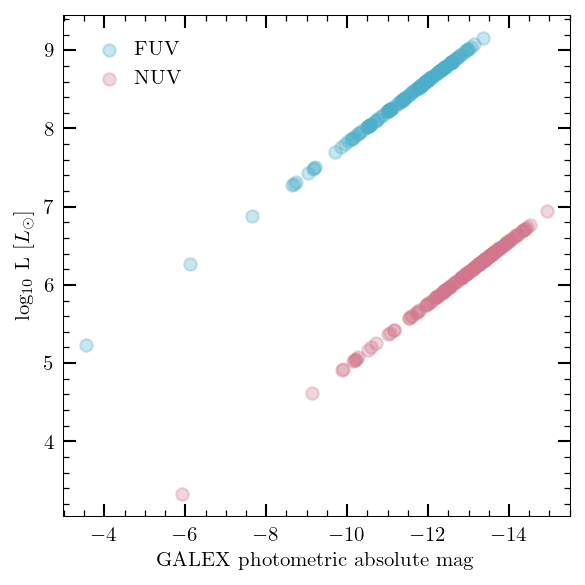

In [22]:
fig, axes = plt.subplots(figsize=(4,4), dpi=150)
axes.scatter(fuv_abs_mags, np.log10(fuv_lums), label='FUV', alpha=0.3)
axes.scatter(nuv_abs_mags, np.log10(nuv_lums), label='NUV', alpha=0.3)
axes.set(xlabel="GALEX photometric absolute mag", ylabel="log$_{10}$ L [$L_{\odot}$]")
axes.invert_xaxis()
axes.legend(loc='best')

# Convert data into absolute magnitudes

In [29]:
absmagphotodf = photodf.copy()
for colname in ['fiber_g_mag', 'full_g_mag','fiber_r_mag', 'full_r_mag','fiber_z_mag', 'full_z_mag',
                'fiber_nuv_mag', 'full_nuv_mag','fiber_fuv_mag', 'full_fuv_mag']:
    for index in range(4272):
        apparent_mag = photodf[colname][index]
        luminosity_dist = compute_luminosity_distance(photodf['z'][index])
        absolute_mag = apparent_to_absolute(apparent_mag, luminosity_dist)
        absmagphotodf[colname][index]=absolute_mag
    print(f"{colname} complete")
absmagphotodf

full_g_mag complete
fiber_r_mag complete
full_r_mag complete
fiber_z_mag complete
full_z_mag complete
fiber_nuv_mag complete
full_nuv_mag complete
fiber_fuv_mag complete
full_fuv_mag complete


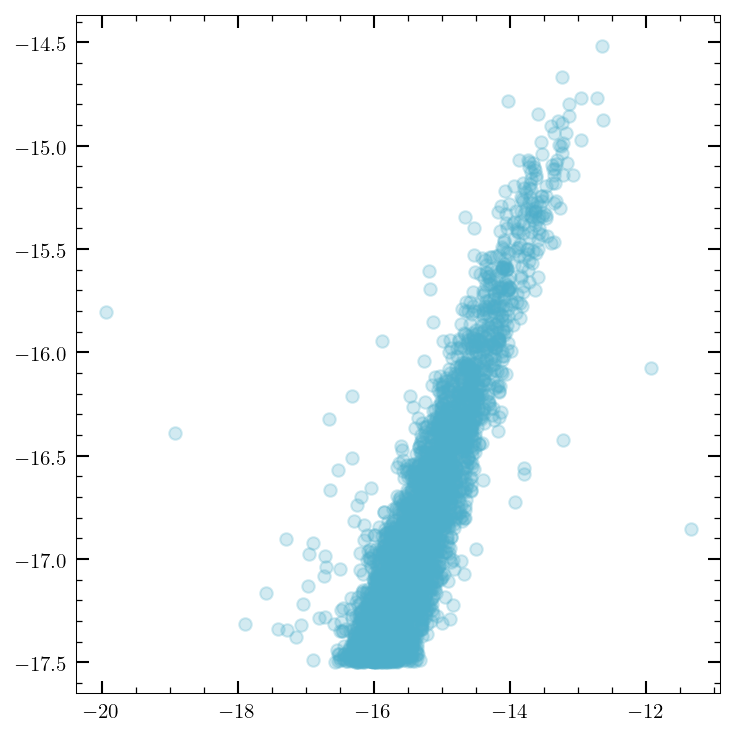

In [35]:
fig, axes = plt.subplots(figsize=(5,5), dpi=150)
axes.scatter(absmagphotodf['full_r_mag'][absmagphotodf['full_r_mag']<900], absmagphotodf['rband'][absmagphotodf['full_r_mag']<900], alpha=0.25)

In [36]:
np.save("absolute_photometric_data_with_z.npy", absmagphotodf)